In [58]:
library(ggalluvial)
library(CellChat)
library(patchwork)
library(graphics)
library(Matrix)
options(stringsAsFactors = FALSE)
library(dplyr)

library(NeuronChat)
# library(CellChat)
library(ggalluvial)
library(glue)
library(Seurat)
library(SeuratDisk)
library(stringr)
library(gridExtra)
library(grid)
library(circlize)
library(colorspace)
library(ComplexHeatmap)
library(NMF)
# source("src/diffInteraction.r")
# source("src/rankNet.r")
source("src/netVisual_chord.R")
# source("src/NMF.r")
# source("src/NMF_and_river_OUT.r")
# source("src/NMF_and_river_IN.r")
# source("src/MY_netAnalysis_river_Neuron.r")
# source("src/MY_mergedRiver.r")

In [3]:
seurat_object <- LoadH5Seurat("/vast/palmer/scratch/gerstein/sx85/PTSD_RNA_data/RNA_FINAL1.h5seurat", meta.data = FALSE, misc = FALSE)


Validating h5Seurat file

Initializing RNA with data

Adding counts for RNA

Adding feature-level metadata for RNA

Adding reduction pca

Adding cell embeddings for pca

Adding miscellaneous information for pca

Adding reduction umap

Adding cell embeddings for umap

Adding miscellaneous information for umap

Adding command information

Adding tool-specific results



In [4]:
seurat_object # FINAL1

An object of class Seurat 
17996 features across 474662 samples within 1 assay 
Active assay: RNA (17996 features, 0 variable features)
 2 dimensional reductions calculated: pca, umap

In [5]:
meta <- read.csv(file = glue('/vast/palmer/scratch/gerstein/sx85/PTSD_RNA_data/RNA_FINAL1_meta.csv'),sep = '\t',row.names='barcodekey')


In [9]:
meta

,n_genes,n_counts,percent_mito,doublet,doublet_score,Channel,scale,leiden_labels,hodge_anno,lake_anno,⋯,Sex,Smoking,Antidepressant,PMI,RIN,Race,AgeDeath,subclass2,subclass_renamed,subclass_final
,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<int>,<chr>,<chr>,⋯,<chr>,<chr>,<int>,<dbl>,<dbl>,<chr>,<dbl>,<chr>,<chr>,<chr>
MS0007NN-CTATAGGAGCTCCACG,8976,42886,7.032598,0,8.168655,MS0007NN,2.521559,13,Inh L4-5 LHX6 PVALB MEPE,In6b,⋯,F,N,0,21.4,7.4,W,18,Inh PVALB,InN PVALB,INH PVALB
MS0007NN-CCCAACTCATCTGCGG,8116,37971,5.620078,0,8.168655,MS0007NN,2.804734,13,Inh L4-5 LHX6 PVALB MEPE,In6b,⋯,F,N,0,21.4,7.4,W,18,Inh PVALB,InN PVALB,INH PVALB
MS0007NN-TCCTCCCGTCTAGGCC,8343,37709,6.417566,0,8.168655,MS0007NN,2.856980,13,Inh L4-5 LHX6 PVALB MEPE,In6b,⋯,F,N,0,21.4,7.4,W,18,Inh PVALB,InN PVALB,INH PVALB
MS0007NN-ACCATTTGTCTACGTA,7962,36582,5.150074,0,8.168655,MS0007NN,2.893184,13,Inh L4-5 LHX6 PVALB MEPE,In6b,⋯,F,N,0,21.4,7.4,W,18,Inh PVALB,InN PVALB,INH PVALB
MS0007NN-CTACAGACAGACCCGT,8286,36337,7.433195,0,8.168655,MS0007NN,2.992847,13,Inh L4-5 LHX6 PVALB MEPE,In6b,⋯,F,N,0,21.4,7.4,W,18,Inh PVALB,InN PVALB,INH PVALB
MS0007NN-CGCCATTCAGGCTACC,8475,33736,5.673465,0,25.506245,MS0007NN,3.168769,13,Inh L4-5 LHX6 PVALB MEPE,In6b,⋯,F,N,0,21.4,7.4,W,18,Inh PVALB,InN PVALB,INH PVALB
MS0007NN-CTGCAGGTCTCCGATC,8194,33188,5.806316,0,8.168655,MS0007NN,3.216986,13,Inh L4-5 LHX6 PVALB MEPE,In6b,⋯,F,N,0,21.4,7.4,W,18,Inh PVALB,InN PVALB,INH PVALB
MS0007NN-TCAAGACAGCCTTCTC,7390,32781,6.692901,0,8.168655,MS0007NN,3.286987,13,Inh L4-5 LHX6 PVALB MEPE,In6b,⋯,F,N,0,21.4,7.4,W,18,Inh PVALB,InN PVALB,INH PVALB
MS0007NN-CAACCAACACAGCCAC,7756,31352,7.010717,0,8.168655,MS0007NN,3.455067,13,Inh L4-5 LHX6 PVALB MEPE,In6b,⋯,F,N,0,21.4,7.4,W,18,Inh PVALB,InN PVALB,INH PVALB


In [6]:
seurat_object2 <- AddMetaData(object = seurat_object, metadata = meta)
print(seurat_object2)

An object of class Seurat 
17996 features across 474662 samples within 1 assay 
Active assay: RNA (17996 features, 0 variable features)
 2 dimensional reductions calculated: pca, umap


In [8]:
data.input <- GetAssayData(seurat_object2, assay = "RNA", slot = "data")
data.input

  [[ suppressing 32 column names ‘MS0007NN-CTATAGGAGCTCCACG’, ‘MS0007NN-CCCAACTCATCTGCGG’, ‘MS0007NN-TCCTCCCGTCTAGGCC’ ... ]]

  [[ suppressing 32 column names ‘MS0007NN-CTATAGGAGCTCCACG’, ‘MS0007NN-CCCAACTCATCTGCGG’, ‘MS0007NN-TCCTCCCGTCTAGGCC’ ... ]]

  [[ suppressing 32 column names ‘MS0007NN-CTATAGGAGCTCCACG’, ‘MS0007NN-CCCAACTCATCTGCGG’, ‘MS0007NN-TCCTCCCGTCTAGGCC’ ... ]]



17996 x 474662 sparse Matrix of class "dgCMatrix"
                                                                                    
FAM87B       .        .        .        .        .        .        .        .       
LINC01128    1.798920 .        1.904189 1.914916 1.384505 1.427621 2.365650 .       
LINC00115    .        1.336246 .        .        .        .        .        .       
FAM41C       .        .        .        .        .        .        .        .       
LINC02593    .        .        .        .        .        .        .        .       
SAMD11       1.258904 .        .        .        .        .        .        .       
NOC2L        .        1.336246 1.349884 .        1.384505 .        1.439121 .       
KLHL17       .        .        .        .        .        1.427621 .        .       
PLEKHN1      .        .        .        .        .        .        .        .       
PERM1        .        .        .        .        .        .        .        .       
HES4         . 

In [14]:
cellchat <- createCellChat(object = data.input, meta = meta, group.by = "subclass_final")


[1] "Create a CellChat object from a data matrix"


Warning message in createCellChat(object = data.input, meta = meta, group.by = "subclass_final"):
“The 'meta' data does not have a column named `samples`. We now add this column and all cells are assumed to belong to `sample1`! 
”


Set cell identities for the new CellChat object 
The cell groups used for CellChat analysis are  ASC, END, EXN CUX2, EXN FEZF2, EXN OPRK1, EXN RORB, INH KCNG1, INH LAMP5, INH PVALB, INH SST, INH VIP, MG, ODC, OPC 


# Set DB

In [15]:
#choose database
CellChatDB <- CellChatDB.human
CellChatDB.use <- subsetDB(CellChatDB, search = "Secreted Signaling") # use Secreted Signaling
#set the used database in the object
cellchat@DB <- CellChatDB.use
cellchat <- subsetData(cellchat)

# Analysis

In [16]:
#analysis
cellchat <- identifyOverExpressedGenes(cellchat)
cellchat <- identifyOverExpressedInteractions(cellchat)

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 2.3 GiB”


The number of highly variable ligand-receptor pairs used for signaling inference is 1002 


In [18]:
type <- 'triMean'
trim <- 0.1
cellchat <- computeCommunProb(cellchat, type = type, trim = trim)


triMean is used for calculating the average gene expression per cell group. 


Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 2.3 GiB”


[1] ">>> Run CellChat on sc/snRNA-seq data <<< [2024-09-06 19:00:47]"
[1] ">>> CellChat inference is done. Parameter values are stored in `object@options$parameter` <<< [2024-09-06 20:07:21]"


In [19]:
saveRDS(cellchat, 
        file = glue("/gpfs/gibbs/pi/xu_ke/yl2693/PTSD_C2C/RNA_FINAL-type_{type}-trim_{trim}_cellchat.rds"))

In [20]:
cellchat <- filterCommunication(cellchat, min.cells = 10)


In [21]:
#Infer the cell-cell communication at a signaling pathway level
cellchat <- computeCommunProbPathway(cellchat)

#Calculate the aggregated cell-cell communication network
cellchat <- aggregateNet(cellchat)

In [23]:
# nPatterns = 3  #default, set to 3
# cellchat <- identifyCommunicationPatterns(cellchat, pattern = "outgoing", k = nPatterns)
# cellchat <- identifyCommunicationPatterns(cellchat, pattern = "incoming", k = nPatterns)


In [24]:
cellchat

An object of class CellChat created from a single dataset 
 17996 genes.
 474662 cells. 
CellChat analysis of single cell RNA-seq data! 

In [46]:
# cellchat@DB$interaction[[cellchat@DB$interaction$ligand == 'GAD1']]
cellchat@DB$interaction[cellchat@DB$interaction$ligand == 'GAD1',]
sum(cellchat@DB$interaction$ligand == 'GAD1')

interaction_name,pathway_name,ligand,receptor,agonist,antagonist,co_A_receptor,co_I_receptor,evidence,annotation,⋯,receptor.symbol,receptor.family,receptor.location,receptor.keyword,receptor.surfaceome_main,receptor.surfaceome_sub,receptor.adhesome,receptor.secreted_type,receptor.transmembrane,version
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<lgl>,<chr>


[1] 0

In [36]:
cellchat@DB$interaction['TGFB2_TGFBR1_TGFBR2',]

,interaction_name,pathway_name,ligand,receptor,agonist,antagonist,co_A_receptor,co_I_receptor,evidence,annotation,⋯,receptor.symbol,receptor.family,receptor.location,receptor.keyword,receptor.surfaceome_main,receptor.surfaceome_sub,receptor.adhesome,receptor.secreted_type,receptor.transmembrane,version
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<lgl>,<chr>
TGFB2_TGFBR1_TGFBR2,TGFB2_TGFBR1_TGFBR2,TGFb,TGFB2,TGFbR1_R2,TGFb agonist,TGFb antagonist,,TGFb inhibition receptor,KEGG: hsa04350,Secreted Signaling,⋯,"TGFBR2, TGFBR1","Protein kinase superfamily, TKL Ser/Thr protein kinase","Cell membrane, Secreted, Membrane raft, Cell surface, Cell junction, Tight junction","Membrane, Secreted, Disulfide bond, Kinase, Transmembrane, Differentiation, ATP-binding, Receptor, Alternative splicing, Aortic aneurysm, Transferase, Glycoprotein, Manganese, Disease variant, Growth regulation, Signal, Reference proteome, Metal-binding, Transmembrane helix, Hereditary nonpolyposis colorectal cancer, Cell membrane, Phosphoprotein, Direct protein sequencing, Apoptosis, Craniosynostosis, Serine/threonine-protein kinase, 3D-structure, Nucleotide-binding, Magnesium, Tight junction, Isopeptide bond, Cell junction, Ubl conjugation",Receptors,Act.TGFB;Kinase,,,TRUE,CellChatDB v1


In [71]:
DB_filename <- paste('interactionDB_','human',sep='')
# data(list=DB_filename)
interactionDB <- eval(parse(text = DB_filename))
# interactionDB <- readRDS(DB_filename)

interactionDB <- interactionDB[!duplicated(names(interactionDB))]
interactionDB <- interactionDB[sort(names(interactionDB),method='radix')]

length(interactionDB)
interactionDB

[1] 190

$`5HT_HTR1A`
$`5HT_HTR1A`$interaction_name
[1] "5HT_HTR1A"

$`5HT_HTR1A`$lig_contributor
     Tph1      Tph2       Ddc   Slc18a1   Slc18a2 
   "TPH1"    "TPH2"     "DDC" "SLC18A1" "SLC18A2" 

$`5HT_HTR1A`$receptor_subunit
  Htr1a 
"HTR1A" 

$`5HT_HTR1A`$lig_contributor_group
[1] 1 1 2 3 3

$`5HT_HTR1A`$lig_contributor_coeff
[1] 1 1 1

$`5HT_HTR1A`$receptor_subunit_group
[1] 1

$`5HT_HTR1A`$receptor_subunit_coeff
[1] 1

$`5HT_HTR1A`$targets_up
character(0)

$`5HT_HTR1A`$targets_down
character(0)

$`5HT_HTR1A`$activator
character(0)

$`5HT_HTR1A`$inhibitor
character(0)

$`5HT_HTR1A`$interactors
character(0)

$`5HT_HTR1A`$interaction_type
[1] "ligand-receptor"

$`5HT_HTR1A`$ligand_type
[1] "Neurotransmitter"


$`5HT_HTR1B`
$`5HT_HTR1B`$interaction_name
[1] "5HT_HTR1B"

$`5HT_HTR1B`$lig_contributor
     Tph1      Tph2       Ddc   Slc18a1   Slc18a2 
   "TPH1"    "TPH2"     "DDC" "SLC18A1" "SLC18A2" 

$`5HT_HTR1B`$receptor_subunit
  Htr1b 
"HTR1B" 

$`5HT_HTR1B`$lig_contributor_group
[1] 1 1 2 3 3

$`5HT_HTR1B`$lig_contributor_coeff
[1] 1 1 1

$`5HT_HTR1B`$receptor_subunit_group
[1] 1

$`5HT_HTR1B`$receptor_subunit_coeff
[1] 1

$`5HT_HTR1B`$targets_up
character(0)

$`5HT_HTR1B`$targets_down
character(0)

$`5HT_HTR1B`$activator
character(0)

$`5HT_HTR1B`$inhibitor
character(0)

$`5HT_HTR1B`$interactors
character(0)

$`5HT_HTR1B`$interaction_type
[1] "ligand-receptor"

$`5HT_HTR1B`$ligand_type
[1] "Neurotransmitter"


$`5HT_HTR1D`
$`5HT_HTR1D`$interaction_name
[1] "5HT_HTR1D"

$`5HT_HTR1D`$lig_contributor
     Tph1      Tph2       Ddc   Slc18a1   Slc18a2 
   "TPH1"    "TPH2"     "DDC" "SLC18A1" "SLC18A2" 

$`5HT_HTR1D`$receptor_subunit
  Htr1d 
"HTR1D" 

$`5HT_HTR1D`$lig_contributor_group
[1] 1 1 2 3 3

$`5HT_HTR1D`$lig_contributor_coeff
[1] 1 1 1

$`5HT_HTR1D`$receptor_subunit_group
[1] 1

$`5HT_HTR1D`$receptor_subunit_coeff
[1] 1

$`5HT_HTR1D`$targets_up
character(0)

$`5HT_HTR1D`$targets_down
character(0)

$`5HT_HTR1D`$activator
character(0)

$`5HT_HTR1D`$inhibitor
character(0)

$`5HT_HTR1D`$interactors
character(0)

$`5HT_HTR1D`$interaction_type
[1] "ligand-receptor"

$`5HT_HTR1D`$ligand_type
[1] "Neurotransmitter"


$`5HT_HTR1E`
$`5HT_HTR1E`$interaction_name
[1] "5HT_HTR1E"

$`5HT_HTR1E`$lig_contributor
     Tph1      Tph2       Ddc   Slc18a1   Slc18a2 
   "TPH1"    "TPH2"     "DDC" "SLC18A1" "SLC18A2" 

$`5HT_HTR1E`$receptor_subunit
  Htr1e 
"HTR1E" 

$`5HT_HTR1E`$lig_contributor_group
[1] 1 1 2 3 3

$`5HT_HTR1E`$lig_contributor_coeff
[1] 1 1 1

$`5HT_HTR1E`$receptor_subunit_group
[1] 1

$`5HT_HTR1E`$receptor_subunit_coeff
[1] 1

$`5HT_HTR1E`$targets_up
character(0)

$`5HT_HTR1E`$targets_down
character(0)

$`5HT_HTR1E`$activator
character(0)

$`5HT_HTR1E`$inhibitor
character(0)

$`5HT_HTR1E`$interactors
character(0)

$`5HT_HTR1E`$interaction_type
[1] "ligand-receptor"

$`5HT_HTR1E`$ligand_type
[1] "Neurotransmitter"


$`5HT_HTR1F`
$`5HT_HTR1F`$interaction_name
[1] "5HT_HTR1F"

$`5HT_HTR1F`$lig_contributor
     Tph1      Tph2       Ddc   Slc18a1   Slc18a2 
   "TPH1"    "TPH2"     "DDC" "SLC18A1" "SLC18A2" 

$`5HT_HTR1F`$receptor_subunit
  Htr1f 
"HTR1F" 

$`5HT_HTR1F`$lig_contributor_group
[1] 1 1 2 3 3

$`5HT_HTR1F`$lig_contributor_coeff
[1] 1 1 1

$`5HT_HTR1F`$receptor_subunit_group
[1] 1

$`5HT_HTR1F`$receptor_subunit_coeff
[1] 1

$`5HT_HTR1F`$targets_up
character(0)

$`5HT_HTR1F`$targets_down
character(0)

$`5HT_HTR1F`$activator
character(0)

$`5HT_HTR1F`$inhibitor
character(0)

$`5HT_HTR1F`$interactors
character(0)

$`5HT_HTR1F`$interaction_type
[1] "ligand-receptor"

$`5HT_HTR1F`$ligand_type
[1] "Neurotransmitter"


$`5HT_HTR2A`
$`5HT_HTR2A`$interaction_name
[1] "5HT_HTR2A"

$`5HT_HTR2A`$lig_contributor
     Tph1      Tph2       Ddc   Slc18a1   Slc18a2 
   "TPH1"    "TPH2"     "DDC" "SLC18A1" "SLC18A2" 

$`5HT_HTR2A`$receptor_subunit
  Htr2a 
"HTR2A" 

$`5HT_HTR2A`$lig_contributor_group
[1] 1 1 2 3 3

$`5HT_HTR2A`$lig_contributor_coeff
[1] 1 1 1

$`5HT_HTR2A`$receptor_subunit_group
[1] 1

$`5HT_HTR2A`$receptor_subunit_coeff

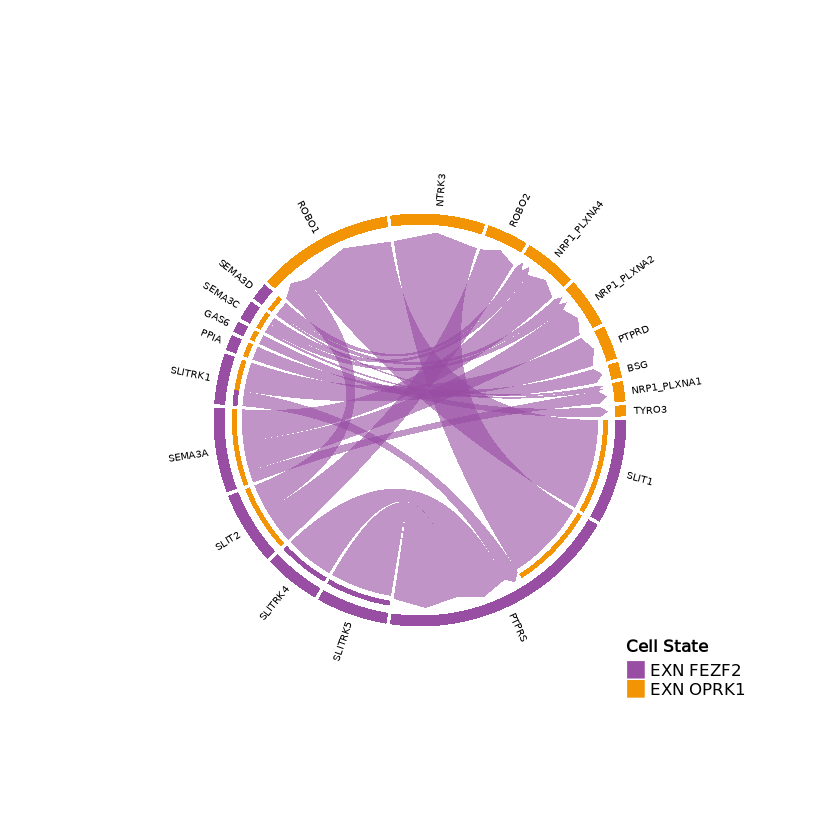

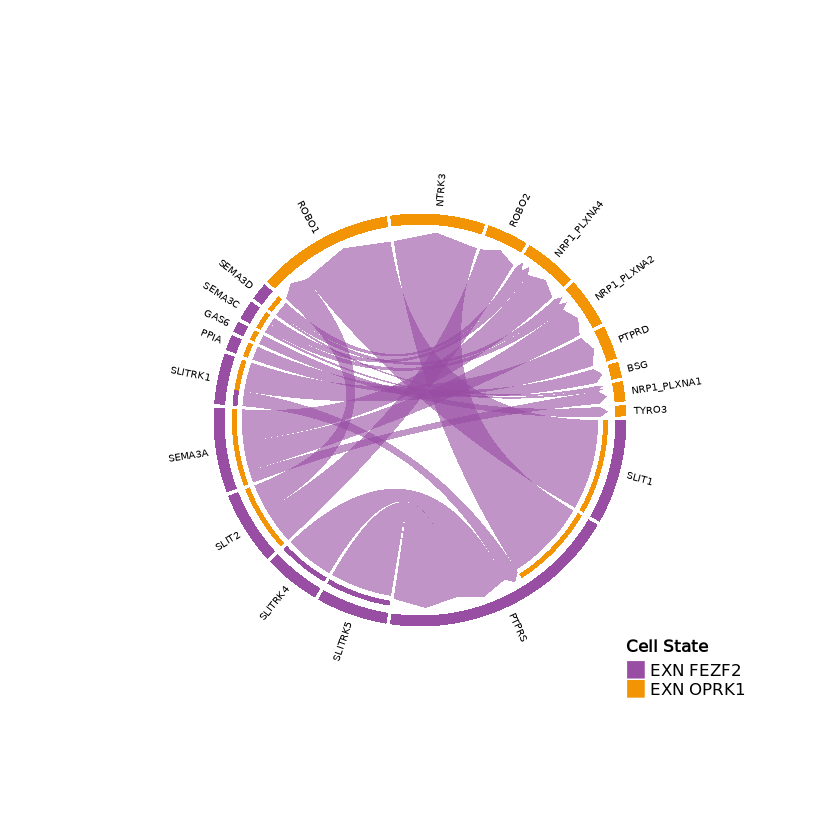

In [33]:
netVisual_individual(cellchat, sources.use = 4, targets.use = c(5:11), lab.cex = 0.5,legend.pos.y = 30)


In [31]:
cellchat@net

,ASC,END,EXN CUX2,EXN FEZF2,EXN OPRK1,EXN RORB,INH KCNG1,INH LAMP5,INH PVALB,INH SST,INH VIP,MG,ODC,OPC
ASC,14,6,9,9,8,8,8,10,11,6,7,1,6,13
END,10,7,8,8,8,7,6,8,7,5,5,1,1,8
EXN CUX2,23,15,19,23,17,18,16,17,18,15,16,4,15,19
EXN FEZF2,21,15,22,23,19,20,13,13,16,12,13,3,14,17
EXN OPRK1,22,11,18,20,17,18,18,18,19,17,18,4,16,21
EXN RORB,21,9,14,18,13,14,15,16,18,13,15,3,15,19
INH KCNG1,11,7,12,11,11,11,11,11,9,7,10,1,7,11
INH LAMP5,14,5,13,14,12,10,13,15,16,12,13,2,10,13
INH PVALB,16,9,12,14,11,11,13,15,17,12,13,3,11,14
INH SST,6,2,7,8,7,6,8,9,8,7,8,1,6,7


In [34]:
netVisual_individual(cellchat, signaling = pathways.show, pairLR.use = LR.show, layout = "chord")


ERROR: Error in searchPair(signaling = signaling, pairLR.use = object@LR$LRsig, : argument "signaling" is missing, with no default


In [50]:
neuronchat <- createNeuronChat(cellchat@data, DB = 'human', group.by = unlist(as.vector(cellchat@meta['subclass_final']), use.names=FALSE), meta=cellchat@meta);


Create a NeuronChat object from a data matrix



In [52]:
neuronchat

  [[ suppressing 32 column names ‘MS0007NN-CTATAGGAGCTCCACG’, ‘MS0007NN-CCCAACTCATCTGCGG’, ‘MS0007NN-TCCTCCCGTCTAGGCC’ ... ]]

  [[ suppressing 32 column names ‘MS0007NN-CTATAGGAGCTCCACG’, ‘MS0007NN-CCCAACTCATCTGCGG’, ‘MS0007NN-TCCTCCCGTCTAGGCC’ ... ]]

  [[ suppressing 32 column names ‘MS0007NN-CTATAGGAGCTCCACG’, ‘MS0007NN-CCCAACTCATCTGCGG’, ‘MS0007NN-TCCTCCCGTCTAGGCC’ ... ]]



An object of class "NeuronChat"
Slot "data.raw":
<0 x 0 matrix>

Slot "data":
17996 x 474662 sparse Matrix of class "dgCMatrix"
                                                                                    
FAM87B       .        .        .        .        .        .        .        .       
LINC01128    1.798920 .        1.904189 1.914916 1.384505 1.427621 2.365650 .       
LINC00115    .        1.336246 .        .        .        .        .        .       
FAM41C       .        .        .        .        .        .        .        .       
LINC02593    .        .        .        .        .        .        .        .       
SAMD11       1.258904 .        .        .        .        .        .        .       
NOC2L        .        1.336246 1.349884 .        1.384505 .        1.439121 .       
KLHL17       .        .        .        .        .        1.427621 .        .       
PLEKHN1      .        .        .        .        .        .        .        .       
PERM1        .        

In [54]:
database = 'human'      # can be 'human' or 'mouse'
agg_method = 'weight'   # ('weight', 'count', 'weighted_count', 'weighted_count2', 'weight_threshold')
num_permutations = 100  # default is 100 
# interaction_pair =  args[3] # sender-receiver pair you want to visualize (such as: "Glu_Gria2")
strict = 0             # (1, or 0) use strict=0 to allow calculation for interaction pairs with missing genes
sender = NULL           # sender cell types (NULL means all cell types are considered)
receiver = NULL         # receiver cell types (NULL means all cell types are considered)
fdr = 0.05              # used for calculating p-value (default is 0.05)
mean_method = 'trimean'      # method used to calculate average gene expression (NULL uses trimean, or "mean")
method = NULL           # either use CellChat or CellPhoneDB for visualizations (NULL uses CellChat)
num_patterns = 3        # number of patterns in communication visualizations (default is 4)
cutoff1 = 0.5           # cutoff for communication strength in visualizations (default is 0.5)
cutoff2 = 0.5           # cutoff for communication strength in visualizations (default is 0.5)
type = "functional"     # type of similarity to use when doing manifold classification ("functional", or "structural")

# NeuronChat <- readRDS(file = 'AD_C2C.rds')

neuronchat <- run_NeuronChat(neuronchat, 
                                 M=num_permutations, 
                                 fdr = fdr, 
                                 mean_method = mean_method, 
                                 method = method, 
                                 # sender = sender, 
                                 # receiver = receiver, 
                                 strict = strict)

ERROR: Error in cal_expr_by_group(df, gene_used, mean_method): object 'yy' not found


In [55]:
x <- run_NeuronChat(neuronchat,M=100)

Time difference of 21.08797 mins


In [56]:
saveRDS(x, 
        file = glue("/gpfs/gibbs/pi/xu_ke/yl2693/PTSD_C2C/RNA_FINAL-type_trimean_neuronchat.rds"))

In [48]:
x <- readRDS("/gpfs/gibbs/pi/xu_ke/yl2693/PTSD_C2C/RNA_FINAL-type_trimean_neuronchat.rds")

In [58]:
net_aggregated_x <- net_aggregation(x@net,method = 'weight')


In [104]:
x@net

,ASC,END,EXN CUX2,EXN FEZF2,EXN OPRK1,EXN RORB,INH KCNG1,INH LAMP5,INH PVALB,INH SST,INH VIP,MG,ODC,OPC
ASC,0,0,0,0,0,0,0,0,0,0,0,0,0,0
END,0,0,0,0,0,0,0,0,0,0,0,0,0,0
EXN CUX2,0,0,0,0,0,0,0,0,0,0,0,0,0,0
EXN FEZF2,0,0,0,0,0,0,0,0,0,0,0,0,0,0
EXN OPRK1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
EXN RORB,0,0,0,0,0,0,0,0,0,0,0,0,0,0
INH KCNG1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
INH LAMP5,0,0,0,0,0,0,0,0,0,0,0,0,0,0
INH PVALB,0,0,0,0,0,0,0,0,0,0,0,0,0,0
INH SST,0,0,0,0,0,0,0,0,0,0,0,0,0,0


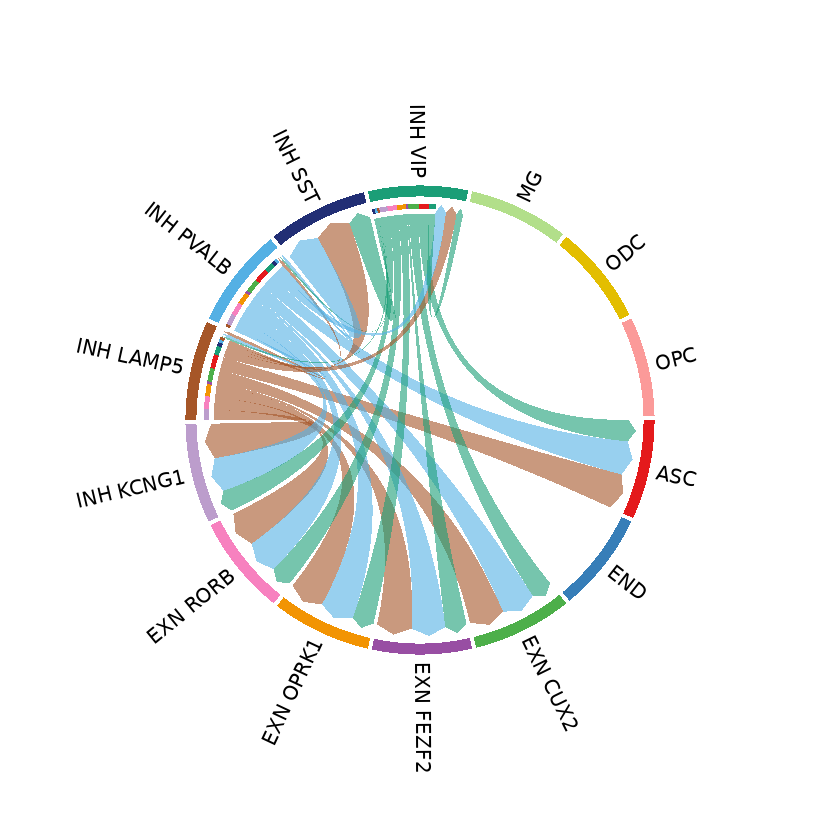

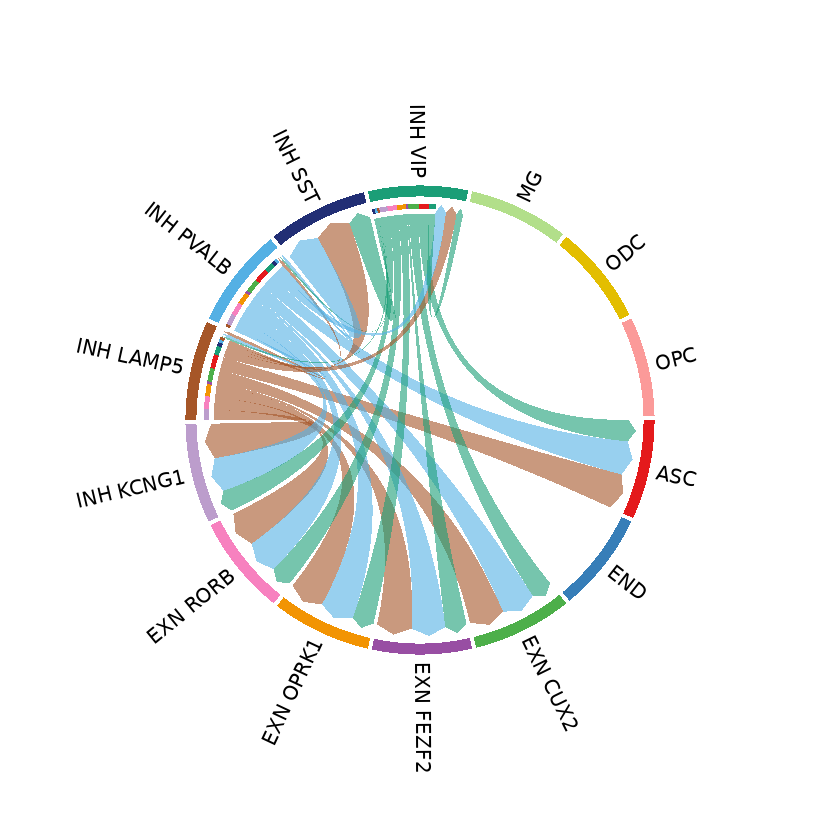

In [106]:
netVisual_chord_neuron(x,interaction_use='GABA_GABRA2',group=NULL,lab.cex = 1)


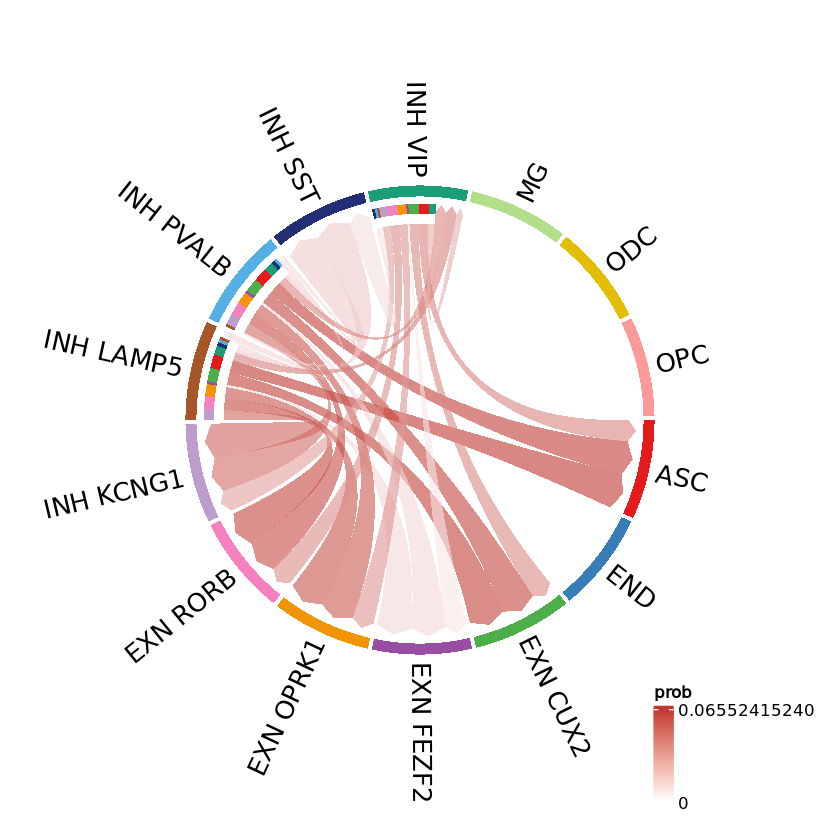

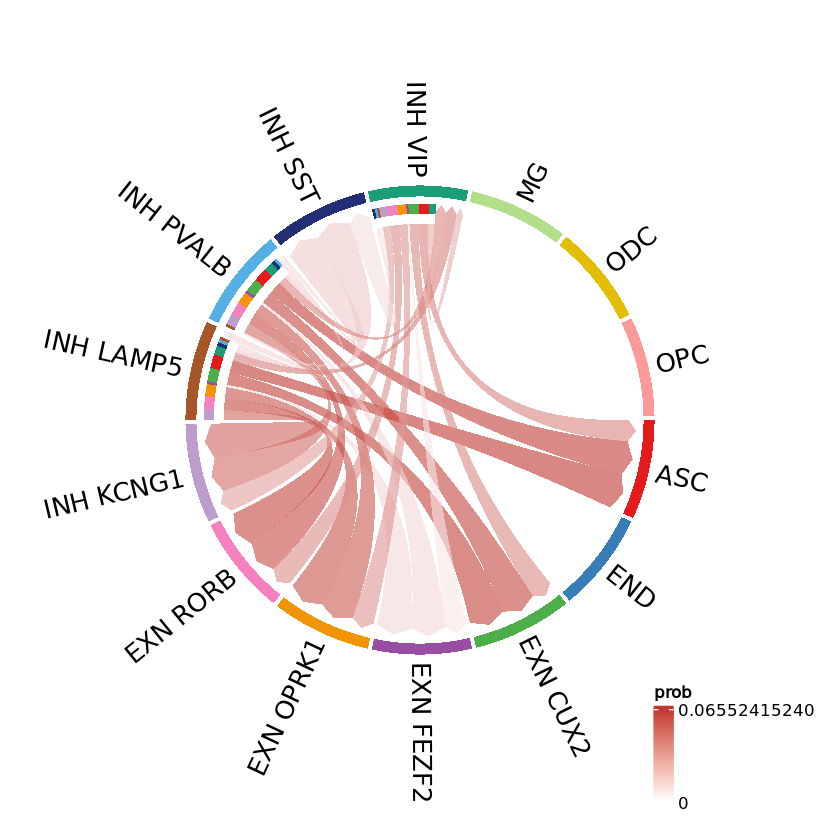

In [102]:
source("src/netVisual_chord.R")

object <- x
interaction_use='GABA_GABRA2'
sender.names=NULL
receiver.names=NULL
method <- 'weight'
if(is.null(sender.names)){sender.names=rownames(object@net[[1]])}
if(is.null(receiver.names)){receiver.names=colnames(object@net[[1]])}
net_aggregated <- net_aggregation(object@net[interaction_use],method=method,cut_off=cut_off)
my_netVisual_chord_cell_internal(net_aggregated, group = NULL,lab.cex=1.3, show.legend = TRUE)
# CellChat::netVisual_chord_cell_internal(net_aggregated, group = NULL,lab.cex=1.3)

In [101]:
aggregate_pairs <- function(pairLR.use.name){
    comparison <- c(1,2)
    object <- neuronchat_obj_PTSDvCON
    net1 <- object@net[[comparison[1]]]
    net2 <- object@net[[comparison[2]]]
    
    thresh <- 0.05
    
    if (length(pairLR.name1) > 1) {
        pairLR.name.use1 <- names(Filter(sum_not_zero, net1[pairLR.use.name]))
    } else {
        pairLR.name.use1 <- pairLR.name1[sum(net1[,,pairLR.name1]) != 0]
    }
    
    if (length(pairLR.name2) > 1) {
        pairLR.name.use2 <- names(Filter(sum_not_zero, net2[pairLR.use.name]))
    } else {
        pairLR.name.use2 <- pairLR.name2[sum(net2[,,pairLR.name2]) != 0]
    }
    
    net1 <- net1[pairLR.name.use1]
    net2 <- net2[pairLR.name.use2]
    net1  <- net_aggregation(net1,  method = agg_method, cut_off = cut_off)
    net2 <- net_aggregation(net2, method = agg_method, cut_off = cut_off)
    
    measure <- 'weight'
    obj1 <- net1
    obj2 <- net2
    melt_1 <- reshape2::melt(obj1, value.name=measure)
    melt_2 <- reshape2::melt(obj2, value.name=measure)
    sum1 <- sum(melt_1[[measure]])
    sum2 <- sum(melt_2[[measure]])
    
    net.diff <- obj2 * (sum1 / sum2) - obj1
    
    net.diff <- net.diff[celltype_name,celltype_name]
}

In [99]:
pairLR.use.name <- c('GABA_GABRA2')

In [102]:
# parameters
agg_method <- "weight_threshold" # 'weight','count','weighted_count','weighted_count2','weight_threshold'
cut_off    <- 0.05
for (i in pairLR.use.name) {
    print(i)
    # if (i %in% c('Glu_GRIN3B')) {
    #     next
    # }
    net.diff <- aggregate_pairs(pairLR.use.name = i)
    plt_chord <- my_netVisual_chord(net.diff, measure = "count", node.color = direction, group=group,
                                title.name = glue("{i}_{agg_method}_{cut_off}"))
    # png(glue("AUD_plot/chord_DOPAMINE/{i}_{agg_method}_{cut_off}.png"), width = 600, height = 600)
    print(plt_chord)
    # dev.off()
}
# i <- 'Glu_GRM8'
# net.diff <- aggregate_pairs(pairLR.use.name = 'Glu_GRM8')
# plt_chord <- my_netVisual_chord(net.diff, measure = "count", node.color = direction,
#                             title.name = glue("{i}_{agg_method}_{cut_off}"))
# png(glue("AUD_plot/chord_Glu/{i}_{agg_method}_{cut_off}.png"), width = 600, height = 600)
# print(plt_chord)
# dev.off()

[1] "GABA_GABRA2"


ERROR: Error in aggregate_pairs(pairLR.use.name = i): object 'neuronchat_obj_PTSDvCON' not found


In [75]:
patterns <- c("^GABARa5")
CON_pairs <- df1[df1$condition == "down",]
CON_pairs <- CON_pairs[grepl(paste(patterns, collapse = "|"), CON_pairs$name), ]
AUD_pairs <- df1[df1$condition == "up",]
AUD_pairs <- AUD_pairs[grepl(paste(patterns, collapse = "|"), AUD_pairs$name), ]
# CON_pairs

subset_CON <- interactionDB[as.character(CON_pairs$name)]
subset_AUD <- interactionDB[as.character(AUD_pairs$name)]

ERROR: Error in eval(expr, envir, enclos): object 'df1' not found


In [96]:
for (name in names(interactionDB))
    if ('GAD1' %in% interactionDB[[name]]$lig_contributor)
        print(name)

[1] "GABA_GABBR1"
[1] "GABA_GABBR2"
[1] "GABA_GABRA1"
[1] "GABA_GABRA2"
[1] "GABA_GABRA3"
[1] "GABA_GABRA4"
[1] "GABA_GABRA5"
[1] "GABA_GABRA6"
[1] "GABA_GABRB1"
[1] "GABA_GABRB2"
[1] "GABA_GABRB3"
[1] "GABA_GABRG1"
[1] "GABA_GABRG2"
[1] "GABA_GABRG3"


In [98]:
for (name in names(interactionDB))
    if ('GAD2' %in% interactionDB[[name]]$lig_contributor)
        print(name)

[1] "GABA_GABBR1"
[1] "GABA_GABBR2"
[1] "GABA_GABRA1"
[1] "GABA_GABRA2"
[1] "GABA_GABRA3"
[1] "GABA_GABRA4"
[1] "GABA_GABRA5"
[1] "GABA_GABRA6"
[1] "GABA_GABRB1"
[1] "GABA_GABRB2"
[1] "GABA_GABRB3"
[1] "GABA_GABRG1"
[1] "GABA_GABRG2"
[1] "GABA_GABRG3"


In [97]:
for (name in names(interactionDB))
    if ('SLC32A1' %in% interactionDB[[name]]$lig_contributor)
        print(name)

[1] "GABA_GABBR1"
[1] "GABA_GABBR2"
[1] "GABA_GABRA1"
[1] "GABA_GABRA2"
[1] "GABA_GABRA3"
[1] "GABA_GABRA4"
[1] "GABA_GABRA5"
[1] "GABA_GABRA6"
[1] "GABA_GABRB1"
[1] "GABA_GABRB2"
[1] "GABA_GABRB3"
[1] "GABA_GABRG1"
[1] "GABA_GABRG2"
[1] "GABA_GABRG3"
[1] "Gly_GLRA1"
[1] "Gly_GLRA2"
[1] "Gly_GLRA3"
[1] "Gly_GLRA4"
[1] "Gly_GLRB"
[1] "Gly_SLC6A5"
[1] "Gly_SLC6A9"


In [115]:
for (name in names(interactionDB))
    if ('GABARA5' %in% interactionDB[[name]]$receptor_subunit)
        print(name)

In [107]:
interactionDB[['GABA_GABRA2']]

$interaction_name
[1] "GABA_GABRA2"

$lig_contributor
     Gad1      Gad2   Slc32a1 
   "GAD1"    "GAD2" "SLC32A1" 

$receptor_subunit
  Gabra2 
"GABRA2" 

$lig_contributor_group
[1] 1 1 2

$lig_contributor_coeff
[1] 1 1

$receptor_subunit_group
[1] 1

$receptor_subunit_coeff
[1] 1

$targets_up
character(0)

$targets_down
character(0)

$activator
[1] "Pcdh19"

$inhibitor
character(0)

$interactors
character(0)

$interaction_type
[1] "ligand-receptor"

$ligand_type
[1] "Neurotransmitter"

In [51]:
lig_tar_heatmap <- function(object, interaction_name, disease='', width.vector=c(1,1), sender.names=NULL,receiver.names=NULL){
if(is.null(sender.names)){sender.names=rownames(object@net[[1]])}
if(is.null(receiver.names)){receiver.names=colnames(object@net[[1]])}
## create Seurat object from NeuronChat object
  meta <- data.frame(cell_subclass=object@data.signaling$cell_subclass)
  rownames(meta) <- rownames(object@data.signaling)
  seurat_VISp <- Seurat::CreateSeuratObject(counts = object@data, meta.data = meta)
  seurat_VISp$groups <- meta$cell_subclass
  SeuratObject::Idents(seurat_VISp) <- meta$cell_subclass
  levels(seurat_VISp) <- sort(unique(c(sender.names,receiver.names)),method='radix')

## plot #2: expression level for ligand related genes
  if(length(object@DB[[interaction_name]]$lig_contributor)>1){
      # c('SLC17A6', 'SLC17A7', 'SLC17A8')
    p1 <- Seurat::VlnPlot(subset(seurat_VISp, idents = sender.names),features = object@DB[[interaction_name]]$lig_contributor,group.by = 'cell_subclass',pt.size = 0,stack = T,flip = T)
    # p1 <- Seurat::VlnPlot(subset(seurat_VISp, idents = sender.names),features = c('SLC17A6', 'SLC17A7', 'SLC17A8'),group.by = 'cell_subclass',pt.size = 0,stack = T,flip = T)
      p1$labels$title <- c('Ligand genes')} else {
      # p1 <- Seurat::VlnPlot(subset(seurat_VISp, idents = sender.names),features = object@DB[[interaction_name]]$lig_contributor,group.by = 'cell_subclass',pt.size = 0)+ theme(legend.position = 'none')
      p1 <- Seurat::VlnPlot(subset(seurat_VISp, idents = sender.names),features = object@DB[[interaction_name]]$lig_contributor,group.by = 'cell_subclass',pt.size = 0)+ theme(legend.position = 'none')
      p1$labels$title <- paste('Ligand gene: ',p1$labels$title)
    }
  p1$theme$plot.title$hjust <- 0.5
## plot #3: expression level for ligand related genes
  p2 <- Seurat::VlnPlot(subset(seurat_VISp, idents = receiver.names),features = object@DB[[interaction_name]]$receptor_subunit,group.by = 'cell_subclass',pt.size = 0) + theme(legend.position = 'none')
  p2$labels$title <- paste('Target gene: ',p2$labels$title)
    
    png(glue("plots/{interaction_name}_ligand_0.1.png"), width = 600, height = 600)
    print(p1)
    dev.off()
    png(glue("plots/{interaction_name}_target_0.1.png"), width = 600, height = 600)
    print(p2)
    dev.off()
    # p1
    # p2
}

In [24]:
lig_tar_heatmap(x,interaction_name='GABA_GABRA2',width.vector=c(0.5,0.5))

png 
  2

# Perturbation analysis

In [25]:
x

  [[ suppressing 32 column names ‘MS0007NN-CTATAGGAGCTCCACG’, ‘MS0007NN-CCCAACTCATCTGCGG’, ‘MS0007NN-TCCTCCCGTCTAGGCC’ ... ]]

  [[ suppressing 32 column names ‘MS0007NN-CTATAGGAGCTCCACG’, ‘MS0007NN-CCCAACTCATCTGCGG’, ‘MS0007NN-TCCTCCCGTCTAGGCC’ ... ]]

  [[ suppressing 32 column names ‘MS0007NN-CTATAGGAGCTCCACG’, ‘MS0007NN-CCCAACTCATCTGCGG’, ‘MS0007NN-TCCTCCCGTCTAGGCC’ ... ]]



An object of class "NeuronChat"
Slot "data.raw":
<0 x 0 matrix>

Slot "data":
17996 x 474662 sparse Matrix of class "dgCMatrix"
                                                                                    
FAM87B       .        .        .        .        .        .        .        .       
LINC01128    1.798920 .        1.904189 1.914916 1.384505 1.427621 2.365650 .       
LINC00115    .        1.336246 .        .        .        .        .        .       
FAM41C       .        .        .        .        .        .        .        .       
LINC02593    .        .        .        .        .        .        .        .       
SAMD11       1.258904 .        .        .        .        .        .        .       
NOC2L        .        1.336246 1.349884 .        1.384505 .        1.439121 .       
KLHL17       .        .        .        .        .        1.427621 .        .       
PLEKHN1      .        .        .        .        .        .        .        .       
PERM1        .        

In [45]:
x@data[,rownames(x@meta[startsWith(x@meta$subclass_final, "INH"),])] <- x@data[,rownames(x@meta[startsWith(x@meta$subclass_final, "INH"),])] * 0.1

In [112]:
x3 <- createNeuronChat(x2@data, DB = 'human', group.by = unlist(as.vector(x2@meta['subclass_final']), use.names=FALSE), meta=x2@meta);


Create a NeuronChat object from a data matrix



In [43]:
rownames(x@meta[startsWith(x@meta$subclass_final, "INH"),])

[1] "MS0007NN-CTATAGGAGCTCCACG" "MS0007NN-CCCAACTCATCTGCGG"
    [3] "MS0007NN-TCCTCCCGTCTAGGCC" "MS0007NN-ACCATTTGTCTACGTA"
    [5] "MS0007NN-CTACAGACAGACCCGT" "MS0007NN-CGCCATTCAGGCTACC"
    [7] "MS0007NN-CTGCAGGTCTCCGATC" "MS0007NN-TCAAGACAGCCTTCTC"
    [9] "MS0007NN-CAACCAACACAGCCAC" "MS0007NN-GCCGATGGTGACGCCT"
   [11] "MS0007NN-CCAATGACAGCAGTTT" "MS0007NN-GATTCGACAATTCTTC"
   [13] "MS0007NN-GCCGATGGTACGGTTT" "MS0007NN-CGAAGGATCAGCTGAT"
   [15] "MS0007NN-CTCTGGTCAACGATTC" "MS0007NN-TCAAGCATCAACCGAT"
   [17] "MS0007NN-AGGGAGTCACTTGTCC" "MS0007NN-AGGTAGGTCTGCTTAT"
   [19] "MS0007NN-GCGAGAACATTCAGGT" "MS0007NN-TCTTAGTGTCCGGTCA"
   [21] "MS0007NN-AACACACGTAGCGATG" "MS0007NN-AGGATAACATGTCAGT"
   [23] "MS0007NN-TCACATTCACGTATAC" "MS0007NN-ATTGGGTCACCGCTGA"
   [25] "MS0007NN-CAGTGCGTCCTATGGA" "MS0007NN-AATAGAGAGACTTCAC"
   [27] "MS0007NN-AGTGCCGCAGATGCGA" "MS0007NN-CTACATTCACAAGTGG"
   [29] "MS0007NN-GTGGTTAAGAGGTGCT" "MS0007NN-GGGCCATCAGTTGTTG"
   [31] "MS0007NN-CAGTTCCGTCATCGCG" "MS0007NN-TCTCCGAGTTAACAGA"
   [33] "MS0007NN-GTACAGTTCTCCGCAT" "MS0007NN-AACCAACCACCTTCCA"
   [35] "MS0007NN-GAATCGTAGAGCCGTA" "MS0007NN-CCTCCAAAGAAAGTCT"
   [37] "MS0007NN-ATGTCTTTCCACGTAA" "MS0007NN-CTCCGATAGCATATGA"
   [39] "MS0007NN-TGACGCGCAAGTATCC" "MS0007NN-TAGACCAAGCTACAAA"
   [41] "MS0007NN-CCTAAGAGTGTTCGAT" "MS0007NN-CTACGGGCAGGTCAAG"
   [43] "MS0007NN-GGTCACGTCGAACACT" "MS0007NN-TATTTCGCACTGAATC"
   [45] "MS0007NN-AATAGAGCACCAGCCA" "MS0007NN-TGGAACTAGCCTTCTC"
   [47] "MS0007NN-CTCCTTTGTGGTCTAT" "MS0007NN-ATTCACTAGAACCCGA"
   [49] "MS0007NN-ACTCTCGGTCTACACA" "MS0007NN-AAGCATCCAGACACCC"
   [51] "MS0007NN-GAGTGTTAGCAACTTC" "MS0007NN-CGATGCGCAGTAGGAC"
   [53] "MS0007NN-ACGATGTAGAGCAAGA" "MS0007NN-CCGGTAGTCTAGGCCG"
   [55] "MS0007NN-TCATTCAAGCAGCAGT" "MS0007NN-TCGCAGGCAGATCATC"
   [57] "MS0007NN-GAGTCTATCTTGCAGA" "MS0007NN-TGTGTGAAGTCAACAA"
   [59] "MS0007NN-AGAACAAGTACAGTAA" "MS0007NN-CTCCTTTCAGGTCCGT"
   [61] "MS0007NN-ACCAACATCCTTATCA" "MS0007NN-ATGACCACACGGTGTC"
   [63] "MS0007NN-CGCGTGAGTTGGGACA" "MS0007NN-CTGCATCCATCGTTCC"
   [65] "MS0007NN-GACATCAAGCACACAG" "MS0007NN-CACTGGGCAGTTGGTT"
   [67] "MS0007NN-TGGTACACACTTGTGA" "MS0007NN-ATTCACTGTTGGGTAG"
   [69] "MS0007NN-CTACCCAAGCCAAGCA" "MS0007NN-TGTTCCGAGCACCTGC"
   [71] "MS0007NN-GTGATGTCATCAGCAT" "MS0007NN-GCCAGGTTCTCCTACG"
   [73] "MS0007NN-ACCTGAAAGTGGAATT" "MS0007NN-GTAGGTTGTTTACCTT"
   [75] "MS0007NN-ATCCTATGTCGTGCCA" "MS0007NN-CCTCAGTGTTGAGGAC"
   [77] "MS0007NN-TGGAGGATCGGAGTGA" "MS0007NN-AAGCATCCACCGGTCA"
   [79] "MS0007NN-GTGTTAGGTCTCACGG" "MS0007NN-GTTAGTGCAACGACAG"
   [81] "MS0007NN-AAGATAGCAGCGATTT" "MS0007NN-TGGGCTGTCATGAGTC"
   [83] "MS0007NN-GAGACCCGTGTCTTAG" "MS0007NN-GGCTTTCTCAATCTCT"
   [85] "MS0007NN-CAGGTATGTTGCGAAG" "MS0007NN-CGTTGGGCATCATGAC"
   [87] "MS0007NN-TACTTGTTCTGCAGCG" "MS0007NN-CTCTGGTAGAATTCAG"
   [89] "MS0007NN-TTGGTTTCAGTCGAGA" "MS0007NN-ATCATTCTCCGTTGGG"
   [91] "MS0007NN-TCGCTCAGTAACCCTA" "MS0007NN-CATAAGCGTTAGTTCG"
   [93] "MS0007NN-TCCCAGTGTATGCGGA" "MS0007NN-TCGCTTGGTGACTGTT"
   [95] "MS0007NN-GGGAGATAGGTTAAAC" "MS0007NN-TAACACGTCAATCAGC"
   [97] "MS0007NN-AGCCAGCAGGGAGGCA" "MS0007NN-CTACATTCATACAGGG"
   [99] "MS0007NN-TCAAGACAGCTAGAAT" "MS0007NN-GTCTTTAGTGGCTCTG"
  [101] "MS0007NN-CGCAGGTGTGACAGCA" "MS0007NN-CTGGACGAGGAGATAG"
  [103] "MS0007NN-TGAGTCAAGGCCCGTT" "MS0007NN-CCGATCTCACCTTCGT"
  [105] "MS0007NN-GTCGTAACAGACACAG" "MS0007NN-GTCAGCGGTGATGAAT"
  [107] "MS0007NN-GCTTGGGTCGCCACTT" "MS0007NN-CATTCTAAGTAAGGGA"
  [109] "MS0007NN-CTCAGGGGTTGCAACT" "MS0007NN-ATTCCCGAGAGCCTGA"
  [111] "MS0007NN-CATGCTCAGAAGGATG" "MS0007NN-GTGTCCTAGACTTAAG"
  [113] "MS0007NN-TCGCACTCACCAAATC" "MS0007NN-ACATTTCCAAGTACCT"
  [115] "MS0007NN-CAGATACTCATGCTAG" "MS0007NN-GAGCTGCAGACAGCGT"
  [117] "MS0007NN-ATCGTGAGTAGCGTTT" "MS0007NN-GACACGCGTCTTGTCC"
  [119] "MS0007NN-GTTTGGAAGAGCCTGA" "MS0007NN-GCACATAGTTGGACCC"
  [121] "MS0007NN-GTCCACTAGACTAGAT" "MS0007NN-GTTCTATCACACACTA"
  [123] "MS0007NN-TACCGGGGTCGGAAAC" "MS0007NN-GTCTGTCGTACACTCA"
  [125] "MS0007NN-TGGAGAGTCCTCTAAT" 

In [113]:
# x2 <- x
x3 <- run_NeuronChat(x3,M=100)

Time difference of 13.80099 mins


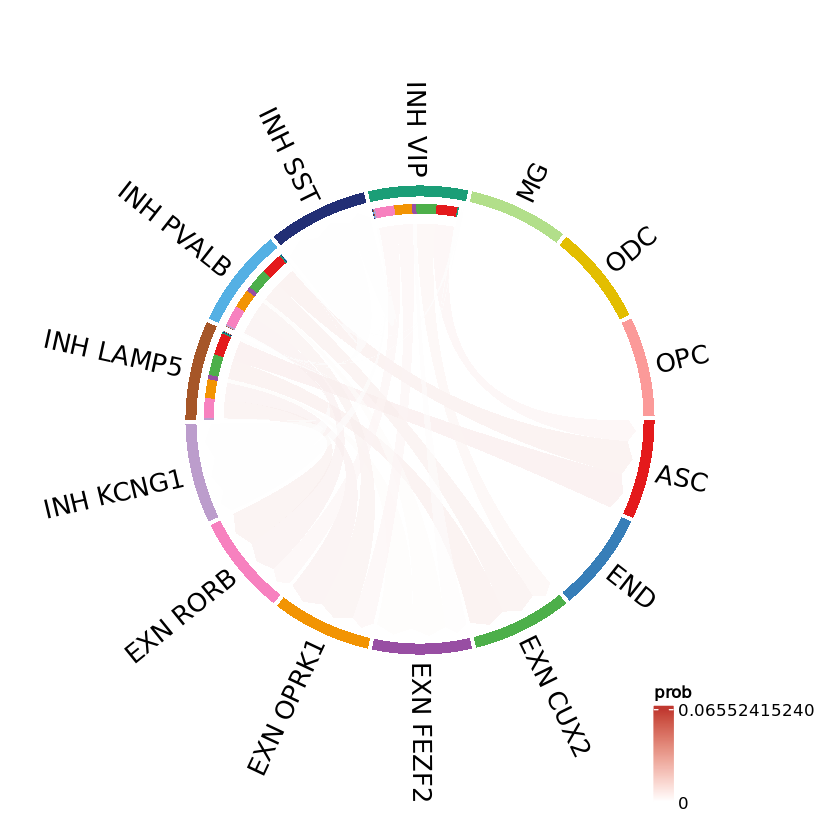

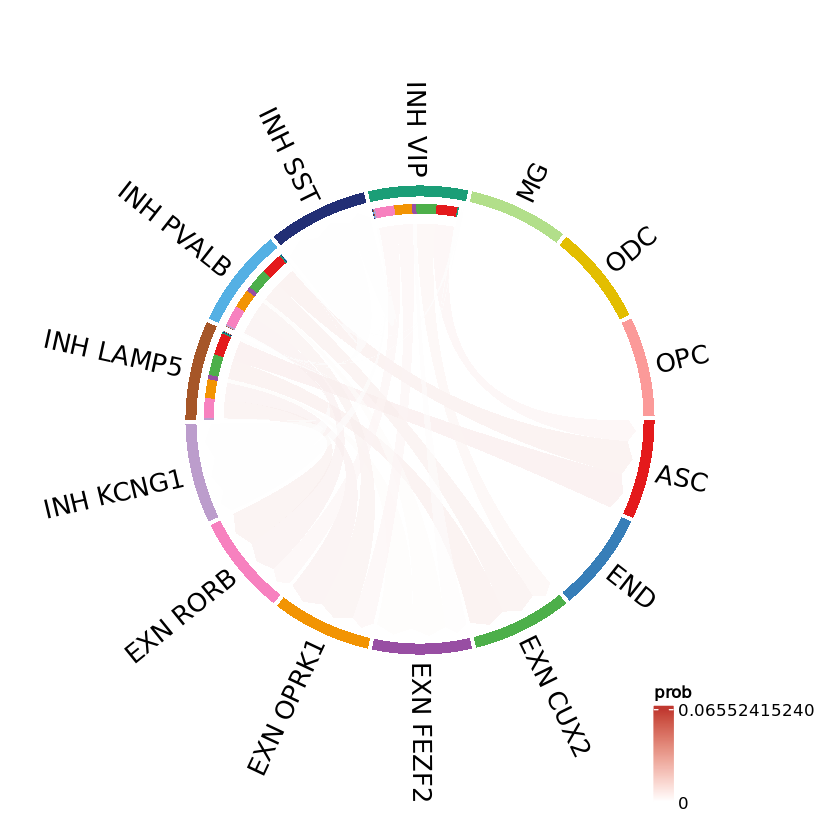

In [120]:
source("src/netVisual_chord.R")

object <- x3
interaction_use='GABA_GABRA2'
sender.names=NULL
receiver.names=NULL
method <- 'weight'
if(is.null(sender.names)){sender.names=rownames(object@net[[1]])}
if(is.null(receiver.names)){receiver.names=colnames(object@net[[1]])}
net_aggregated <- net_aggregation(object@net[interaction_use],method=method,cut_off=cut_off)
my_netVisual_chord_cell_internal(net_aggregated, group = NULL,lab.cex=1.3,show.legend = TRUE)
# CellChat::netVisual_chord_cell_internal(net_aggregated, group = NULL,lab.cex=1.3)

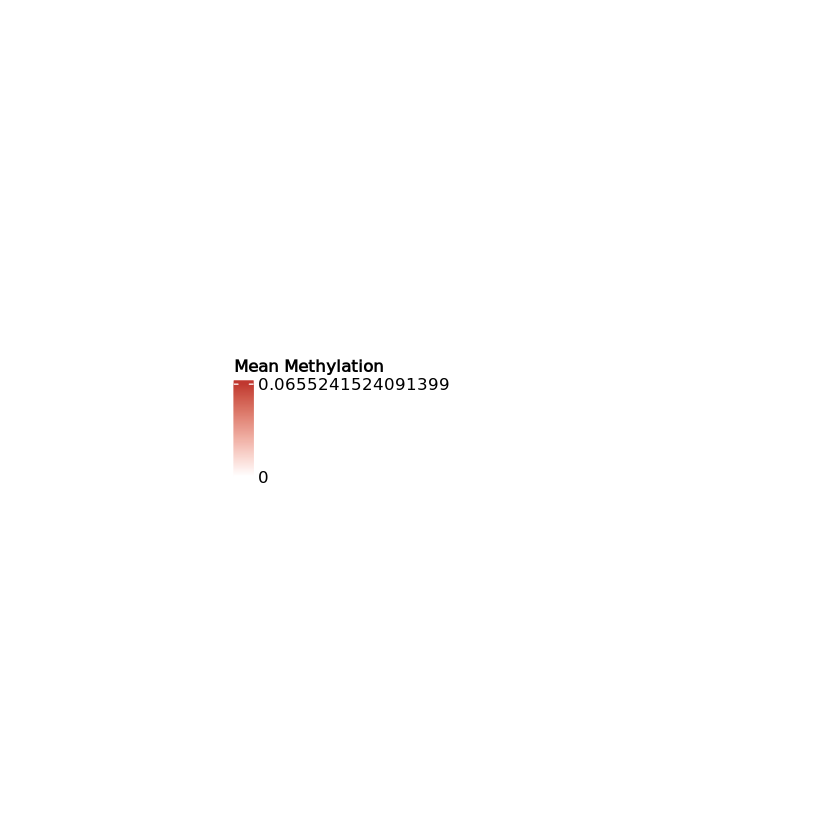

In [87]:
range_value <- max(abs(net$prob))
    ### Create a custom color palette from red to blue
    # color_ramp <- colorRamp(c("blue", "white", "red"))
    color_ramp <- colorRamp2(c(0,range_value),c( "white", "#C03830")) # milder
    # color_ramp <- colorRamp(c("#333333", "white", "#333333")) # all gray
    
    # edge.color <- rgb(color_ramp((net$prob + range_value) / (2 * range_value)), maxColorValue = 255)  
lgd <- Legend(title = "Mean Methylation", at = c(0,max(abs(net$prob))), col_fun = color_ramp)
      draw(lgd,  just = "right")

In [83]:
c(0,range_value)

[1] 0.06552415

In [116]:
net_aggregated <- net_aggregation(x@net[interaction_use],method=method,cut_off=cut_off)
net <- net_aggregated
net <- reshape2::melt(net, value.name = "prob")
net

Var1,Var2,prob
<fct>,<fct>,<dbl>
ASC,ASC,0.00000000
END,ASC,0.00000000
EXN CUX2,ASC,0.00000000
EXN FEZF2,ASC,0.00000000
EXN OPRK1,ASC,0.00000000
EXN RORB,ASC,0.00000000
INH KCNG1,ASC,0.00000000
INH LAMP5,ASC,0.06552415
INH PVALB,ASC,0.06329798


In [119]:
range_value <- max(abs(net$prob))
(net$prob + range_value) / (2 * range_value)
range_value

[1] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
  [8] 1.0000000 0.9830126 0.5000000 0.8077291 0.5000000 0.5000000 0.5000000
 [15] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
 [22] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
 [29] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
 [36] 0.9790379 0.9627626 0.5000000 0.7948278 0.5000000 0.5000000 0.5000000
 [43] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
 [50] 0.5993533 0.5959777 0.5000000 0.5611478 0.5000000 0.5000000 0.5000000
 [57] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
 [64] 0.9287879 0.9142199 0.5000000 0.7639010 0.5000000 0.5000000 0.5000000
 [71] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
 [78] 0.9603367 0.9446968 0.5000000 0.7833180 0.5000000 0.5000000 0.5000000
 [85] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
 [92] 0.8827348 0.8697315 0.5000000 0.7355573 0.5000000 0.5000000 0.5000000
 [99] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
[106] 0.6044188 0.6008711 0.5000000 0.5642654 0.5000000 0.5000000 0.5000000
[113] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
[120] 0.6044293 0.6008813 0.5000000 0.5642719 0.5000000 0.5000000 0.5000000
[127] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
[134] 0.6313051 0.6268440 0.5000000 0.5808128 0.5000000 0.5000000 0.5000000
[141] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
[148] 0.8163112 0.8055646 0.5000000 0.6946763 0.5000000 0.5000000 0.5000000
[155] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
[162] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
[169] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
[176] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
[183] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000
[190] 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000 0.5000000

[1] 0.06552415

In [52]:
lig_tar_heatmap(x2,interaction_name='GABA_GABRA2',width.vector=c(0.5,0.5))

png 
  2

In [49]:
x@data[,rownames(x@meta[startsWith(x@meta$subclass_final, "INH"),])]

  [[ suppressing 32 column names ‘MS0007NN-CTATAGGAGCTCCACG’, ‘MS0007NN-CCCAACTCATCTGCGG’, ‘MS0007NN-TCCTCCCGTCTAGGCC’ ... ]]

  [[ suppressing 32 column names ‘MS0007NN-CTATAGGAGCTCCACG’, ‘MS0007NN-CCCAACTCATCTGCGG’, ‘MS0007NN-TCCTCCCGTCTAGGCC’ ... ]]

  [[ suppressing 32 column names ‘MS0007NN-CTATAGGAGCTCCACG’, ‘MS0007NN-CCCAACTCATCTGCGG’, ‘MS0007NN-TCCTCCCGTCTAGGCC’ ... ]]



17996 x 76262 sparse Matrix of class "dgCMatrix"
                                                                                    
FAM87B       .        .        .        .        .        .        .        .       
LINC01128    1.798920 .        1.904189 1.914916 1.384505 1.427621 2.365650 .       
LINC00115    .        1.336246 .        .        .        .        .        .       
FAM41C       .        .        .        .        .        .        .        .       
LINC02593    .        .        .        .        .        .        .        .       
SAMD11       1.258904 .        .        .        .        .        .        .       
NOC2L        .        1.336246 1.349884 .        1.384505 .        1.439121 .       
KLHL17       .        .        .        .        .        1.427621 .        .       
PLEKHN1      .        .        .        .        .        .        .        .       
PERM1        .        .        .        .        .        .        .        .       
HES4         .  

In [50]:
x2@data[,rownames(x@meta[startsWith(x@meta$subclass_final, "INH"),])]

  [[ suppressing 32 column names ‘MS0007NN-CTATAGGAGCTCCACG’, ‘MS0007NN-CCCAACTCATCTGCGG’, ‘MS0007NN-TCCTCCCGTCTAGGCC’ ... ]]

  [[ suppressing 32 column names ‘MS0007NN-CTATAGGAGCTCCACG’, ‘MS0007NN-CCCAACTCATCTGCGG’, ‘MS0007NN-TCCTCCCGTCTAGGCC’ ... ]]

  [[ suppressing 32 column names ‘MS0007NN-CTATAGGAGCTCCACG’, ‘MS0007NN-CCCAACTCATCTGCGG’, ‘MS0007NN-TCCTCCCGTCTAGGCC’ ... ]]



17996 x 76262 sparse Matrix of class "dgCMatrix"
                                                                                  
FAM87B       .         .         .         .         .         .         .        
LINC01128    0.1798920 .         0.1904189 0.1914916 0.1384505 0.1427621 0.2365650
LINC00115    .         0.1336246 .         .         .         .         .        
FAM41C       .         .         .         .         .         .         .        
LINC02593    .         .         .         .         .         .         .        
SAMD11       0.1258904 .         .         .         .         .         .        
NOC2L        .         0.1336246 0.1349884 .         0.1384505 .         0.1439121
KLHL17       .         .         .         .         .         0.1427621 .        
PLEKHN1      .         .         .         .         .         .         .        
PERM1        .         .         .         .         .         .         .        
HES4         .         0.1336246 0.134

In [103]:
net_aggregated <- net_aggregation(x@net[interaction_use],method=method,cut_off=cut_off)
net_aggregated2 <- net_aggregation(x2@net[interaction_use],method=method,cut_off=cut_off)

In [104]:
net_aggregated

,ASC,END,EXN CUX2,EXN FEZF2,EXN OPRK1,EXN RORB,INH KCNG1,INH LAMP5,INH PVALB,INH SST,INH VIP,MG,ODC,OPC
ASC,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0
END,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0
EXN CUX2,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0
EXN FEZF2,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0
EXN OPRK1,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0
EXN RORB,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0
INH KCNG1,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0
INH LAMP5,0.06552415,0,0.06277710,0.013020075,0.05619192,0.06032635,0.05015675,0.01368390,0.013685279,0.01720731,0.04145205,0,0,0
INH PVALB,0.06329798,0,0.06064425,0.012577720,0.05428281,0.05827677,0.04845268,0.01321899,0.013220323,0.01662269,0.04004372,0,0,0
INH SST,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0


In [105]:
net_aggregated2

,ASC,END,EXN CUX2,EXN FEZF2,EXN OPRK1,EXN RORB,INH KCNG1,INH LAMP5,INH PVALB,INH SST,INH VIP,MG,ODC,OPC
ASC,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0
END,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0
EXN CUX2,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0
EXN FEZF2,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0
EXN OPRK1,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0
EXN RORB,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0
INH KCNG1,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0
INH LAMP5,0.06552415,0,0.06277710,0.013020075,0.05619192,0.06032635,0.05015675,0.01368390,0.013685279,0.01720731,0.04145205,0,0,0
INH PVALB,0.06329798,0,0.06064425,0.012577720,0.05428281,0.05827677,0.04845268,0.01321899,0.013220323,0.01662269,0.04004372,0,0,0
INH SST,0.00000000,0,0.00000000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,0.00000000,0,0,0


In [109]:
x2@net['GABA_GABRA4']

,ASC,END,EXN CUX2,EXN FEZF2,EXN OPRK1,EXN RORB,INH KCNG1,INH LAMP5,INH PVALB,INH SST,INH VIP,MG,ODC,OPC
ASC,0,0,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0,0,0
END,0,0,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0,0,0
EXN CUX2,0,0,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0,0,0
EXN FEZF2,0,0,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0,0,0
EXN OPRK1,0,0,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0,0,0
EXN RORB,0,0,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0,0,0
INH KCNG1,0,0,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0,0,0
INH LAMP5,0,0,0.05647226,0.03441462,0.05230290,0.04456634,0.03780457,0.04908747,0.04578520,0.04413764,0.01642322,0,0,0
INH PVALB,0,0,0.05455362,0.03324539,0.05052591,0.04305220,0.03652017,0.04741973,0.04422965,0.04263807,0.01586524,0,0,0
INH SST,0,0,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0,0,0


In [108]:
x@net

,ASC,END,EXN CUX2,EXN FEZF2,EXN OPRK1,EXN RORB,INH KCNG1,INH LAMP5,INH PVALB,INH SST,INH VIP,MG,ODC,OPC
ASC,0,0,0,0,0,0,0,0,0,0,0,0,0,0
END,0,0,0,0,0,0,0,0,0,0,0,0,0,0
EXN CUX2,0,0,0,0,0,0,0,0,0,0,0,0,0,0
EXN FEZF2,0,0,0,0,0,0,0,0,0,0,0,0,0,0
EXN OPRK1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
EXN RORB,0,0,0,0,0,0,0,0,0,0,0,0,0,0
INH KCNG1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
INH LAMP5,0,0,0,0,0,0,0,0,0,0,0,0,0,0
INH PVALB,0,0,0,0,0,0,0,0,0,0,0,0,0,0
INH SST,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [111]:
x2@data.signaling

,TPH1,TPH2,DDC,SLC18A1,SLC18A2,HTR1A,HTR1B,HTR1D,HTR1E,HTR2A,⋯,RXFP3,SST,TAC1,TACR1,TAC3,TACR3,TRH,TRHR,VIP,cell_subclass
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
MS0007NN-CTATAGGAGCTCCACG,0,0,0,0,0.0000000,0,0,0,0.0000000,0.0000000,⋯,0,0.0000000,0.4818073,0.2464803,0,0,0,0.0000000,0,INH PVALB
MS0007NN-CCCAACTCATCTGCGG,0,0,0,0,0.0000000,0,0,0,0.0000000,0.1533578,⋯,0,0.0000000,0.4158392,0.2573342,0,0,0,0.0000000,0,INH PVALB
MS0007NN-TCCTCCCGTCTAGGCC,0,0,0,0,0.0000000,0,0,0,0.0000000,0.1549230,⋯,0,0.0000000,0.4089655,0.3770281,0,0,0,0.0000000,0,INH PVALB
MS0007NN-ACCATTTGTCTACGTA,0,0,0,0,0.0000000,0,0,0,0.0000000,0.0000000,⋯,0,0.0000000,0.4784649,0.1559953,0,0,0,0.0000000,0,INH PVALB
MS0007NN-CTACAGACAGACCCGT,0,0,0,0,0.1588963,0,0,0,0.0000000,0.2230927,⋯,0,0.0000000,0.3938454,0.1588963,0,0,0,0.0000000,0,INH PVALB
MS0007NN-CGCCATTCAGGCTACC,0,0,0,0,0.0000000,0,0,0,0.1638446,0.0000000,⋯,0,0.3001833,0.5381387,0.2287322,0,0,0,0.0000000,0,INH PVALB
MS0007NN-CTGCAGGTCTCCGATC,0,0,0,0,0.1651644,0,0,0,0.0000000,0.1651644,⋯,0,0.1651644,0.3771271,0.0000000,0,0,0,0.0000000,0,INH PVALB
MS0007NN-TCAAGACAGCCTTCTC,0,0,0,0,0.0000000,0,0,0,0.3478827,0.1670539,⋯,0,0.0000000,0.3795062,0.3280605,0,0,0,0.0000000,0,INH PVALB
MS0007NN-CAACCAACACAGCCAC,0,0,0,0,0.1714676,0,0,0,0.0000000,0.3334633,⋯,0,0.0000000,0.3850250,0.1714676,0,0,0,0.0000000,0,INH PVALB


In [115]:
saveRDS(x3, 
        file = glue("/gpfs/gibbs/pi/xu_ke/yl2693/PTSD_C2C/RNA_FINAL-type_trimean_neuronchat_perturbation_0.1.rds"))